# Image to image with Azure Computer Vision and Azure Open AI for Dall-E3

We are going to use **Azure Computer Vision 4 Florence** to get the main caption and the tags from an existing image.
Then we will use these information as a prompt to generate an artificial image using **Azure Open AI and Dall-e 3** integration.

In [1]:
# %pip install openai --upgrade

In [15]:
import json
import openai
import os
import requests
import sys

from dotenv import load_dotenv
from IPython.display import Image as viewimage
from matplotlib import pyplot as plt
from openai import AzureOpenAI

In [3]:
IMAGES_DIR = "real_images"

In [4]:
RESULTS_DIR = "artificial_images"

os.makedirs(RESULTS_DIR, exist_ok=True)

In [5]:
sys.version

'3.10.10 (main, Mar 21 2023, 18:45:11) [GCC 11.2.0]'

In [6]:
load_dotenv("azure.env")

# Azure Open AI
openai.api_type: str = "azure"
api_key = os.getenv("OPENAI_API_KEY")
api_base = os.getenv("OPENAI_API_BASE")
api_version = "2023-12-01-preview"

print("Open AI version:", openai.__version__)

# Azure Computer Vision
azure_cv_endpoint = os.getenv("AZURE_CV_ENDPOINT")
azure_cv_key = os.getenv("AZURE_CV_API_KEY")

Open AI version: 1.3.0


## Functions

In [7]:
client = AzureOpenAI(
    api_version=api_version,
    azure_endpoint=api_base,
    api_key=api_key,
)

In [8]:
def get_caption(imagefile):
    """
    Get caption from an image using Azure Computer Vision 4
    """
    # settings
    options = "&features=caption,tags"
    model = "?api-version=2023-02-01-preview&modelVersion=latest"
    url = azure_cv_endpoint + "/computervision/imageanalysis:analyze" + model + options
    headers = {
        "Content-type": "application/octet-stream",
        "Ocp-Apim-Subscription-Key": azure_cv_key,
    }

    # Read the image file
    with open(imagefile, "rb") as f:
        data = f.read()

    # Sending the requests
    r = requests.post(url, data=data, headers=headers)
    results = r.json()
    # Parsing the results
    image_caption = results["captionResult"]["text"]
    tags = results["tagsResult"]["values"]
    tags_str = ",".join(item["name"] for item in tags)
    image_desc = image_caption + "," + tags_str

    return image_desc

In [9]:
def dalle3(prompt, size="1792x1024", quality="hd", style="vivid"):
    """
    Dall e3 image
    """
    result = client.images.generate(
        model="dalle3",  # Name of the Dall e3 deployed model
        prompt=prompt,  # Prompt
        n=1,  # Number of images
        size=size,  # 1792x1024 or 1024x1024 or 1024x1792
        quality=quality,  # hd or standard
        style=style,  # natural or vivid
    )
    # Loading the json results
    results = json.loads(result.model_dump_json())
    # Getting the url image (the first one)
    dalleimage = requests.get(results["data"][0]["url"]).content
    # Saving the image as a local file

    image_file = os.path.join(RESULTS_DIR, prompt[:50].replace(",", " ") + ".png")

    with open(image_file, "wb") as imagefile:
        imagefile.write(dalleimage)

    return image_file

In [10]:
def side_by_side(image1, image2):
    """
    Display two images side by side
    """
    # Reading images
    img1 = plt.imread(image1)
    img2 = plt.imread(image2)

    # Subplots
    f, ax = plt.subplots(1, 2, figsize=(15, 8))
    ax[0].imshow(img1)
    ax[1].imshow(img2)

    # Titles
    ax[0].set_title("Initial real image")
    ax[1].set_title("Artificial Dall-E3 image")
    title = "Image to image with Azure AI"
    f.suptitle(title, fontsize=15)
    plt.tight_layout()

    # Removing the axis
    ax[0].axis("off")
    ax[1].axis("off")

    plt.show()

## Testing

In [11]:
jpg_files = [file for file in os.listdir(IMAGES_DIR) if file.endswith(".jpg")]
jpg_files

['image (1).jpg',
 'image (2).jpg',
 'image (3).jpg',
 'image (4).jpg',
 'image (5).jpg',
 'image (6).jpg',
 'image (7).jpg',
 'image (8).jpg',
 'image (9).jpg']

real_images/image (1).jpg


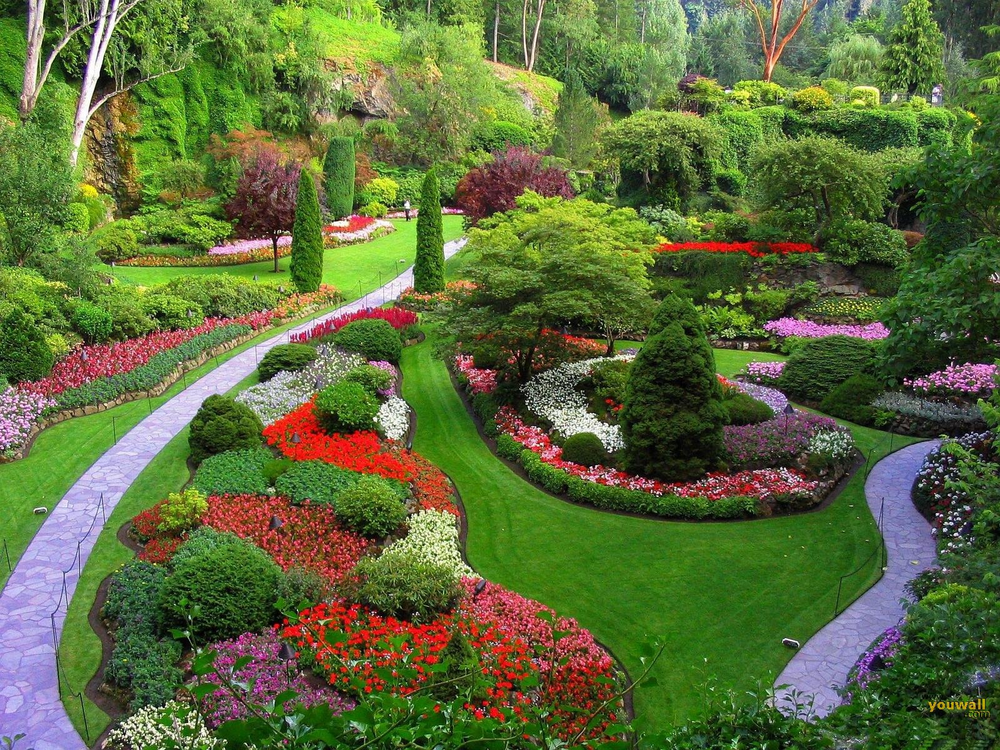

In [22]:
file = jpg_files[0]
imagefile = os.path.join(IMAGES_DIR, file)
print(imagefile)
viewimage(filename=imagefile, width=512)

In [13]:
caption = get_caption(imagefile)
print(caption)

a garden with many different flowers with Butchart Gardens in the background,tree,botanical garden,outdoor,landscaping,garden,shrub,grass,groundcover,plant,hedge,annual plant,park,yard,spring,flower


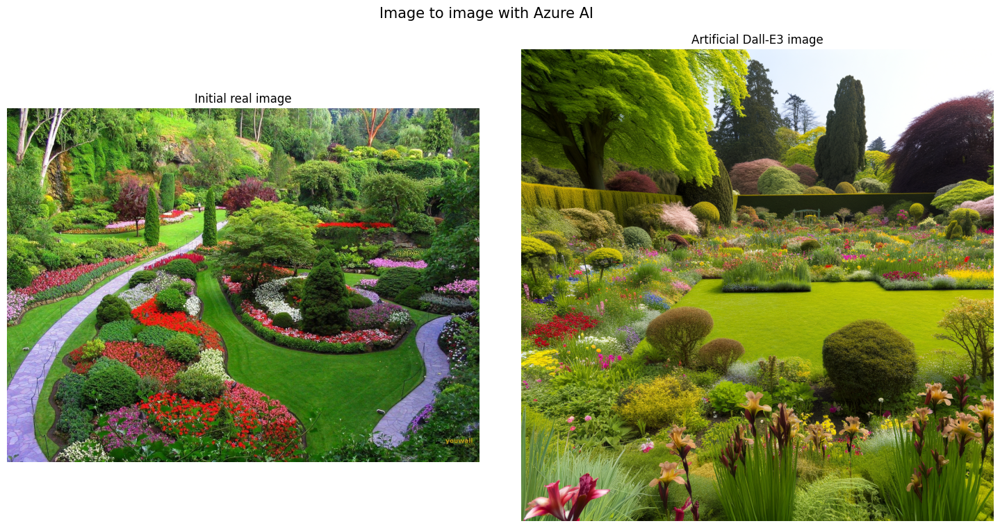

In [16]:
outputfile = dalle3(caption, size="1024x1024", quality="hd", style="natural")
side_by_side(imagefile, outputfile)

real_images/image (2).jpg


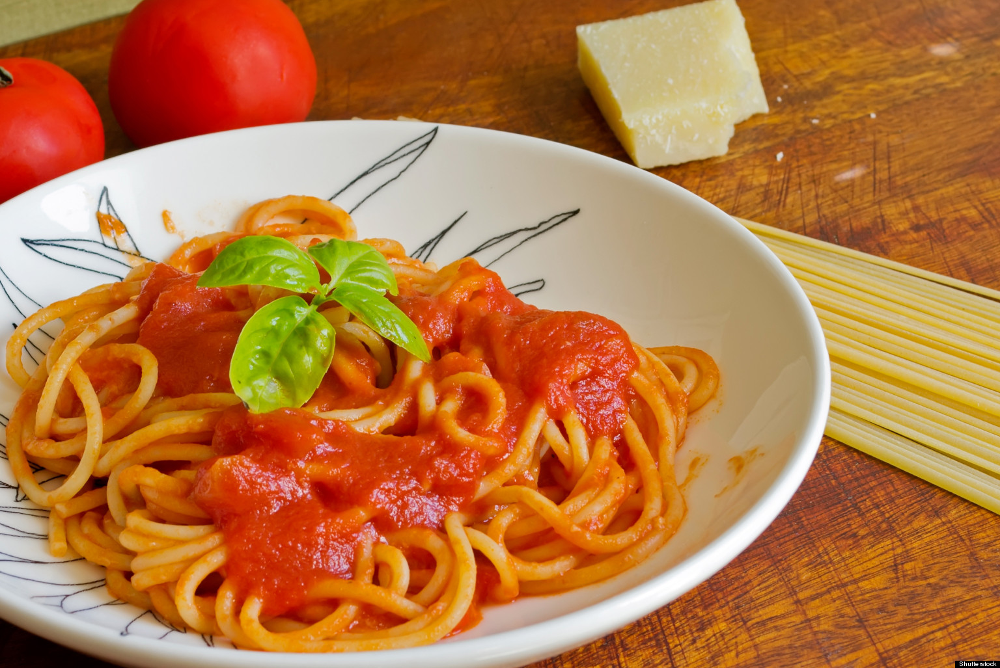

In [23]:
file = jpg_files[1]
imagefile = os.path.join(IMAGES_DIR, file)
print(imagefile)
viewimage(filename=imagefile, width=512)

In [18]:
caption = get_caption(imagefile)
print(caption)

a plate of spaghetti with sauce and basil on top,food,dish,cuisine,italian food,ingredient,staple food,pasta pomodoro,noodle,vegetable,indoor,al dente,spaghetti,sauces,tomato,pasta,table


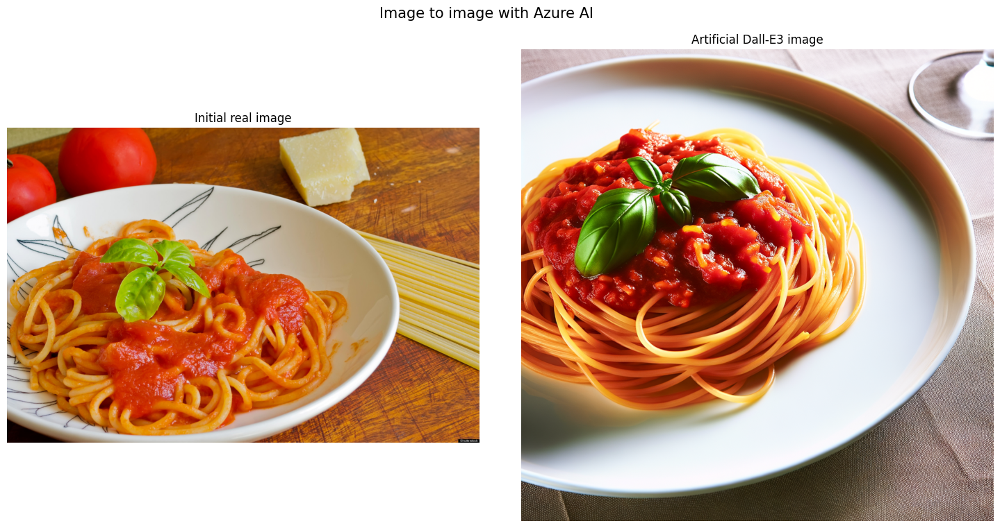

In [19]:
outputfile = dalle3(caption, size="1024x1024", quality="hd", style="natural")
side_by_side(imagefile, outputfile)

real_images/image (3).jpg


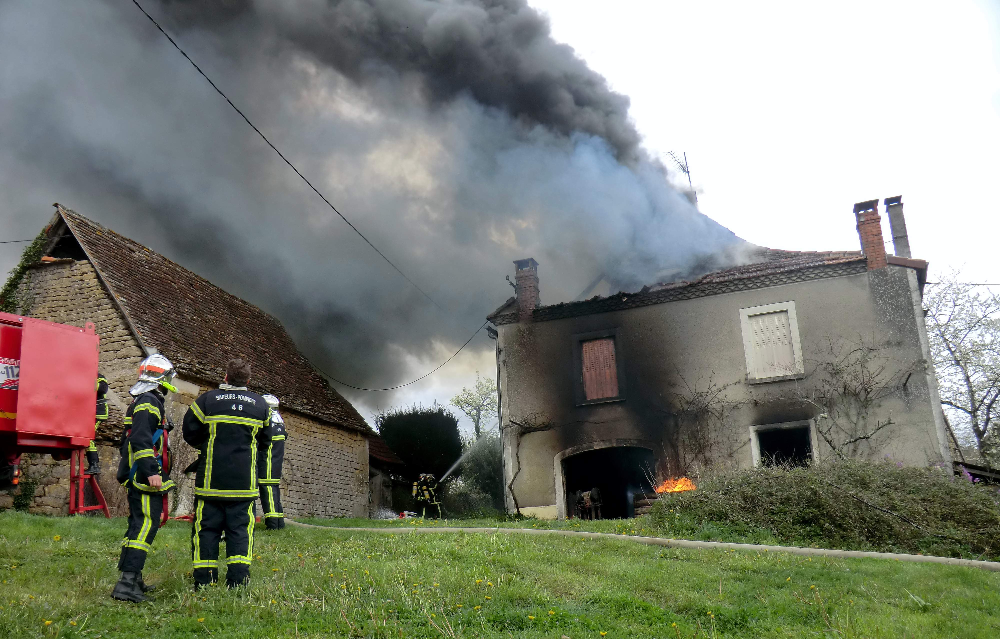

In [24]:
file = jpg_files[2]
imagefile = os.path.join(IMAGES_DIR, file)
print(imagefile)
viewimage(filename=imagefile, width=512)

In [21]:
caption = get_caption(imagefile)
print(caption)

a firemen standing in front of a building with smoke coming out of it,outdoor,sky,grass,firefighter,cloud,fire,pollution,building,disaster,smoke


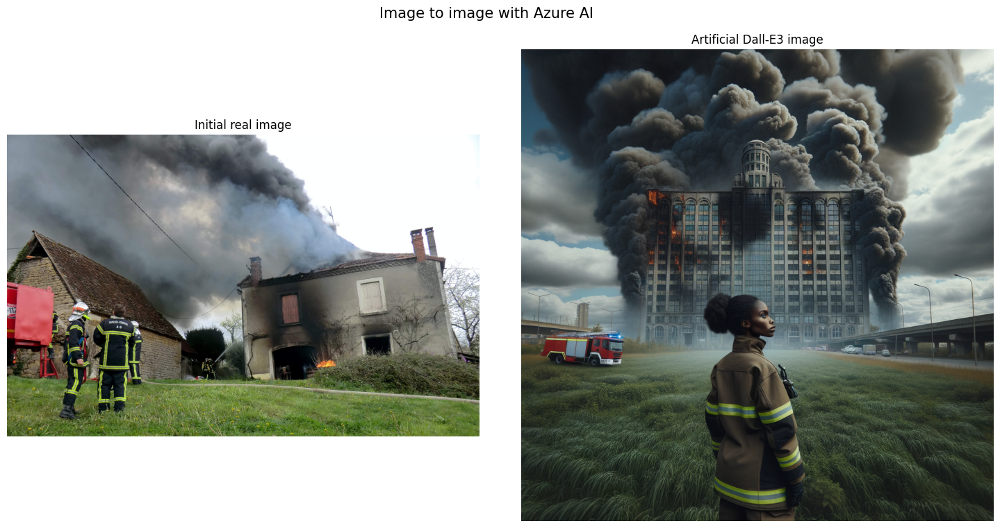

In [25]:
outputfile = dalle3(caption, size="1024x1024", quality="hd", style="vivid")
side_by_side(imagefile, outputfile)

real_images/image (4).jpg


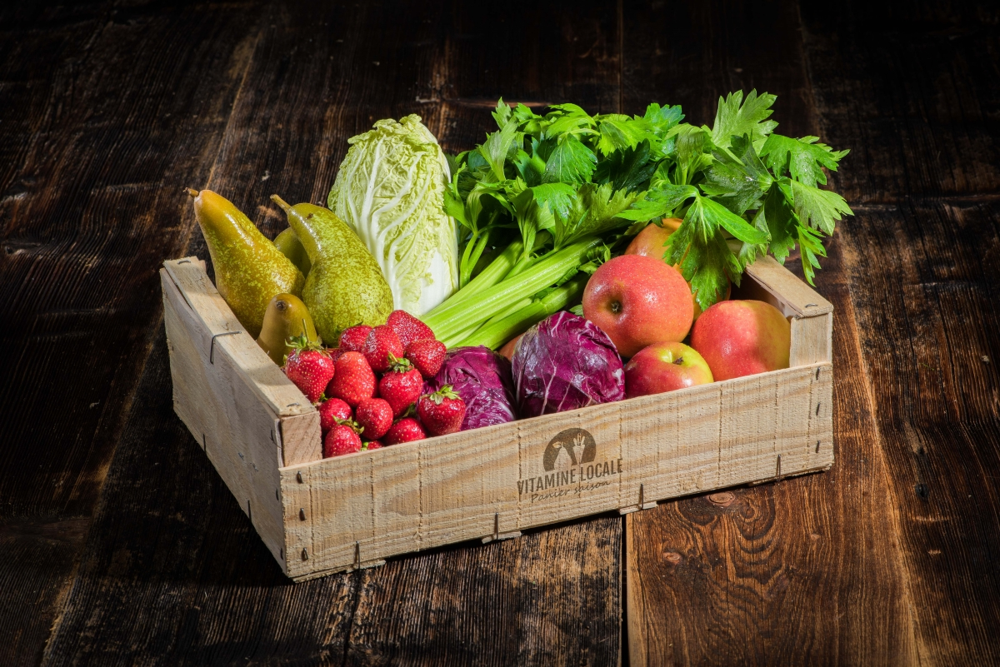

In [26]:
file = jpg_files[3]
imagefile = os.path.join(IMAGES_DIR, file)
print(imagefile)
viewimage(filename=imagefile, width=512)

In [27]:
caption = get_caption(imagefile)
print(caption)

a wooden box of vegetables,natural foods,whole food,vegan nutrition,local food,diet food,superfood,food group,vegetarian food,leaf vegetable,greengrocer,staple food,cruciferous vegetables,ingredient,still life,food,root vegetable,apple,vegetable,fruit,wooden,indoor,fresh,floor,wood,produce,plant,lettuce


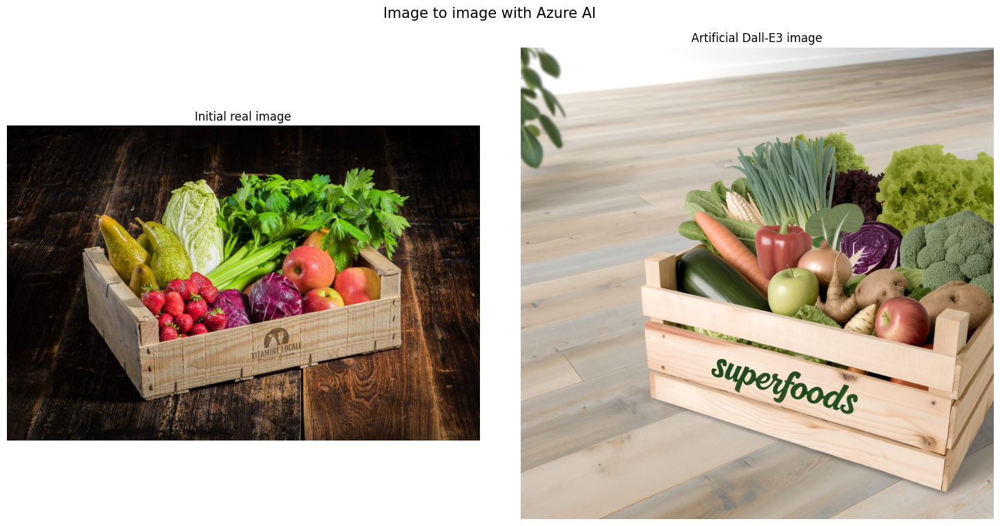

In [28]:
outputfile = dalle3(caption, size="1024x1024", quality="hd", style="natural")
side_by_side(imagefile, outputfile)

real_images/image (5).jpg


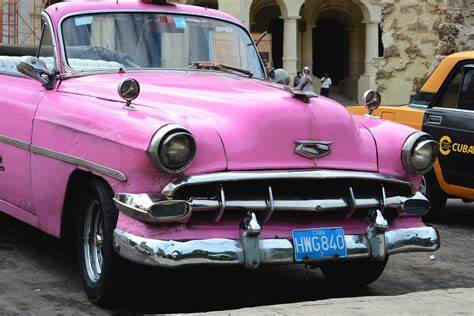

In [29]:
file = jpg_files[4]
imagefile = os.path.join(IMAGES_DIR, file)
print(imagefile)
viewimage(filename=imagefile, width=512)

In [30]:
caption = get_caption(imagefile)
print(caption)

a pink car parked on the side of a road,land vehicle,vehicle,wheel,classic car,car,hardtop,antique car,chevrolet bel air,outdoor,auto part,hood,1957 chevrolet,motor vehicle,parked,purple


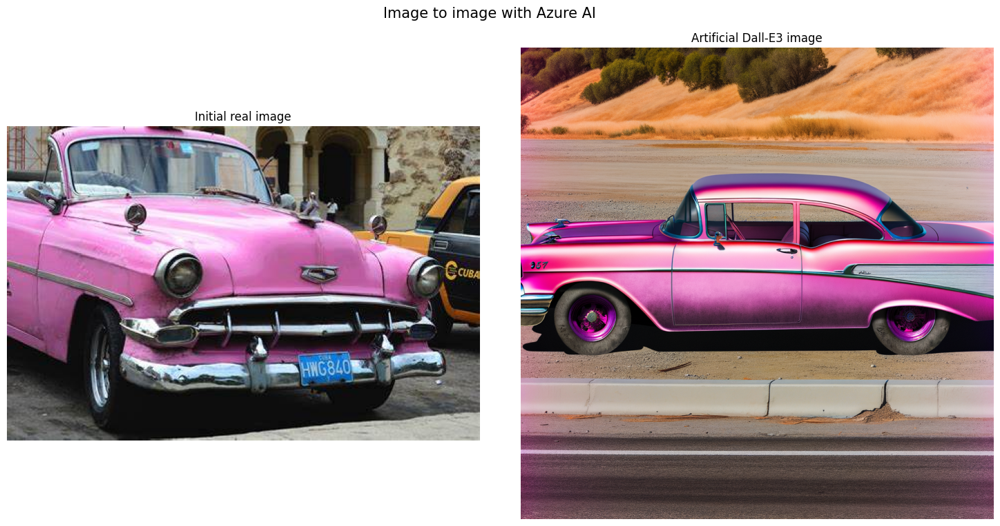

In [31]:
outputfile = dalle3(caption, size="1024x1024", quality="hd", style="natural")
side_by_side(imagefile, outputfile)

real_images/image (6).jpg


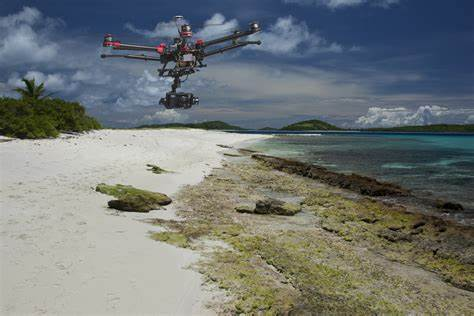

In [50]:
file = jpg_files[5]
imagefile = os.path.join(IMAGES_DIR, file)
print(imagefile)
viewimage(filename=imagefile, width=512)

In [51]:
caption = get_caption(imagefile)
print(caption)

a drone flying over a beach,outdoor,cloud,sky,beach,water,ground,landscape


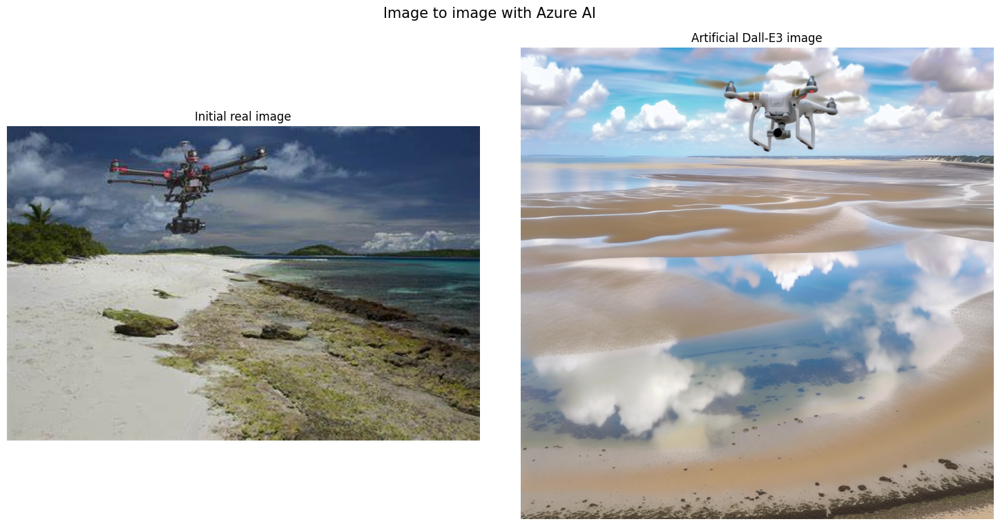

In [52]:
outputfile = dalle3(caption, size="1024x1024", quality="standard", style="natural")
side_by_side(imagefile, outputfile)

real_images/image (7).jpg


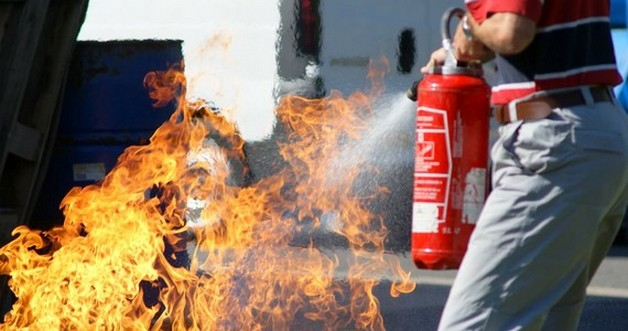

In [53]:
file = jpg_files[6]
imagefile = os.path.join(IMAGES_DIR, file)
print(imagefile)
viewimage(filename=imagefile, width=512)

In [54]:
caption = get_caption(imagefile)
print(caption)

a fire extinguisher spraying water,outdoor,fire,firefighter,fire extinguisher,clothing,person,smoke,flame,pollution,man,red


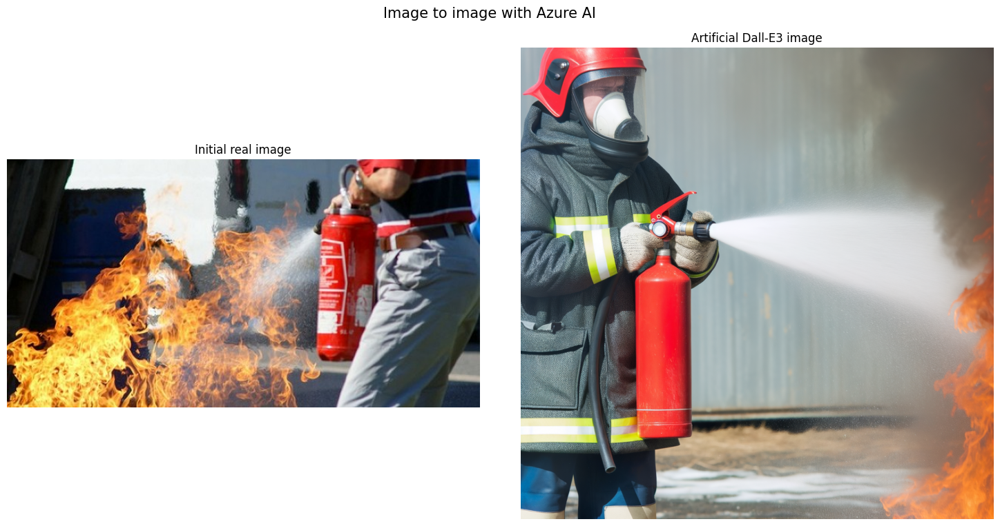

In [55]:
outputfile = dalle3(caption, size="1024x1024", quality="hd", style="natural")
side_by_side(imagefile, outputfile)

real_images/image (8).jpg


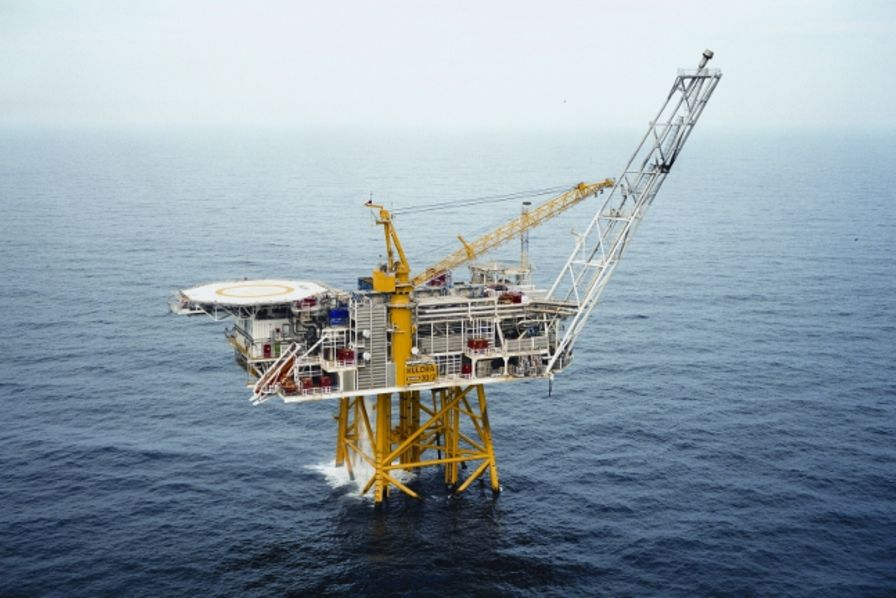

In [38]:
file = jpg_files[7]
imagefile = os.path.join(IMAGES_DIR, file)
print(imagefile)
viewimage(filename=imagefile, width=512)

In [39]:
caption = get_caption(imagefile)
print(caption)

a large crane on a platform in the ocean,water,sky,outdoor,hoisting,sea,gear,ship,crane


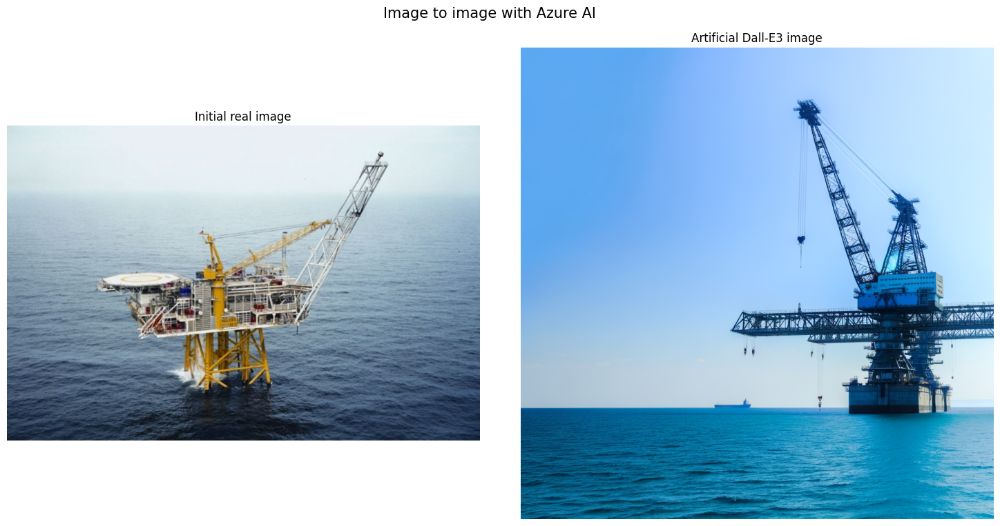

In [40]:
outputfile = dalle3(caption, size="1024x1024", quality="hd", style="natural")
side_by_side(imagefile, outputfile)

real_images/image (9).jpg


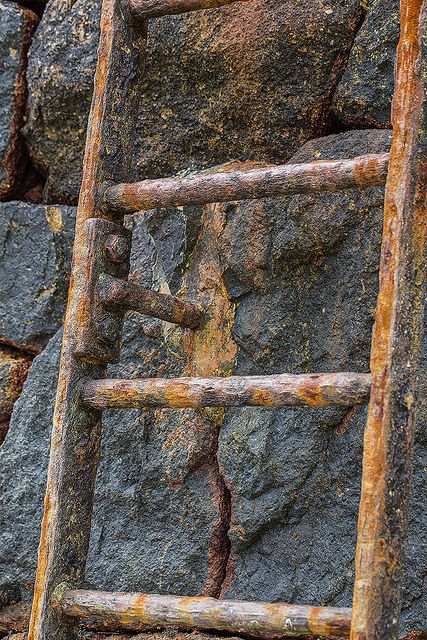

In [56]:
file = jpg_files[8]
imagefile = os.path.join(IMAGES_DIR, file)
print(imagefile)
viewimage(filename=imagefile, width=512)

In [57]:
caption = get_caption(imagefile)
print(caption)

a rusty ladder leaning against a rock wall,building,rust,stone,outdoor,rock,abstract


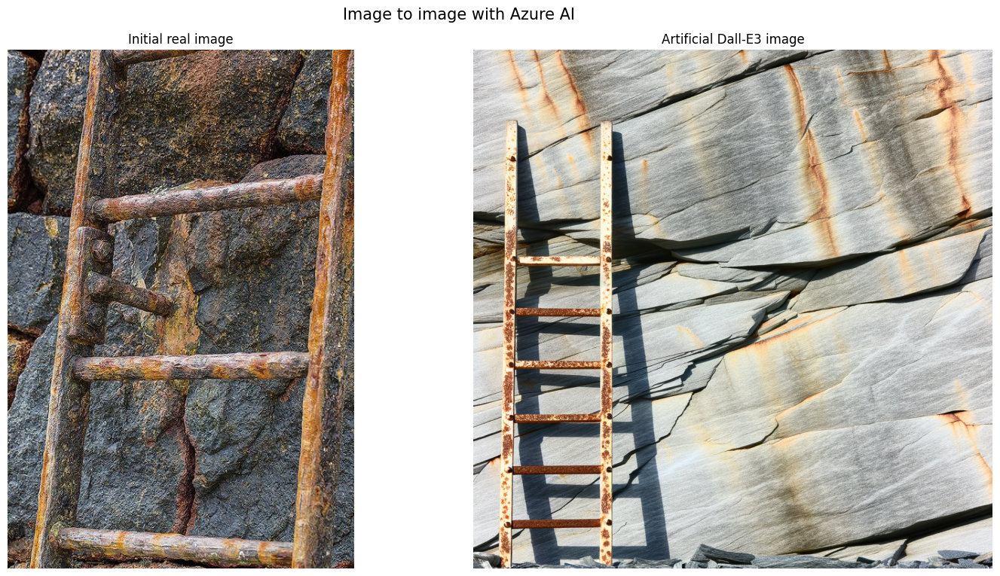

In [58]:
outputfile = dalle3(caption, size="1024x1024", quality="hd", style="natural")
side_by_side(imagefile, outputfile)